In [2]:
import glob
from itertools import chain
import os
import random
import zipfile
from tqdm.notebook import tqdm

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from PIL import Image
from sklearn.model_selection import train_test_split
import cv2

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim.lr_scheduler import StepLR, CosineAnnealingLR, ReduceLROnPlateau
from torch.utils.data import DataLoader, Dataset
from torchvision import datasets, transforms, models

E:\Programe\Anacondaa\envs\pytorch_ultimate\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Dataset Preparation
#### Dataset link : https://www.robots.ox.ac.uk/~vgg/data/oxbuildings/
#### Imaginile sunt descarcate de pe linkul de mai sus si salvate intr-un folder numit oxford_dataset

In [2]:
# get a list of all files in the 'oxford_dataset' directory
file_list = os.listdir('oxford_dataset')

# create a dictionary to store the images by class
classes = {}

# iterate through the list of files
for file in file_list:
  # extract the class name from the file name
    split_class_name = file.split('_')
    if len(split_class_name) == 3:
        class_name = split_class_name[0] + "_" + split_class_name[1]
    
    if len(split_class_name) == 2:
        class_name = split_class_name[0]

    # add the image to the list of images for the corresponding class
    file = os.path.join(class_name, file)
    file = os.path.join("data", file)
    if class_name in classes:
        classes[class_name].append(file)
    else:
        classes[class_name] = [file]

# the classes dictionary now contains the images grouped by class
for class_name in classes:
    os.makedirs(os.path.join("data", class_name))
    
import shutil
# Save each value to its corresponding folder
for class_name, values in classes.items():
    for value in values:
        file_name = value.split("\\")[2]
        src = os.path.join("oxford_dataset", file_name)
        dst = value
        try:
            shutil.move(src, dst)
        except:
            pass

In [ ]:
# get a list of all files in the 'oxford_dataset' directory
file_list = os.listdir('oxford_dataset')

# create a dictionary to store the images by class
classes = {}

# iterate through the list of files
for file in file_list:
  # extract the class name from the file name
    split_class_name = file.split('_')
    if len(split_class_name) == 3:
        class_name = split_class_name[0] + "_" + split_class_name[1]
    
    if len(split_class_name) == 2:
        class_name = split_class_name[0]

    # add the image to the list of images for the corresponding class
    file = os.path.join(class_name, file)
    file = os.path.join("data", file)
    if class_name in classes:
        classes[class_name].append(file)
    else:
        classes[class_name] = [file]

In [ ]:
classes_array = list(classes.keys())
classes_dict = {value: position + 1 for position, value in enumerate(classes_array)}
print(classes_dict)

# Set directory to rename folders in
data_dir = 'data'

# Loop over old and new folder names
for old_name, new_name in classes_dict.items():
    # Construct old and new folder paths
    new_name = str(new_name)
    old_folder_path = os.path.join(data_dir, old_name)
    new_folder_path = os.path.join(data_dir, new_name)

    # Rename folder
    os.rename(old_folder_path, new_folder_path)

In [ ]:
import splitfolders

splitfolders.ratio("data", output="oxford_dataset_splited",
    seed=1337, ratio=(.8, .1, .1), group_prefix=None, move=False) # default values
# minunat✨

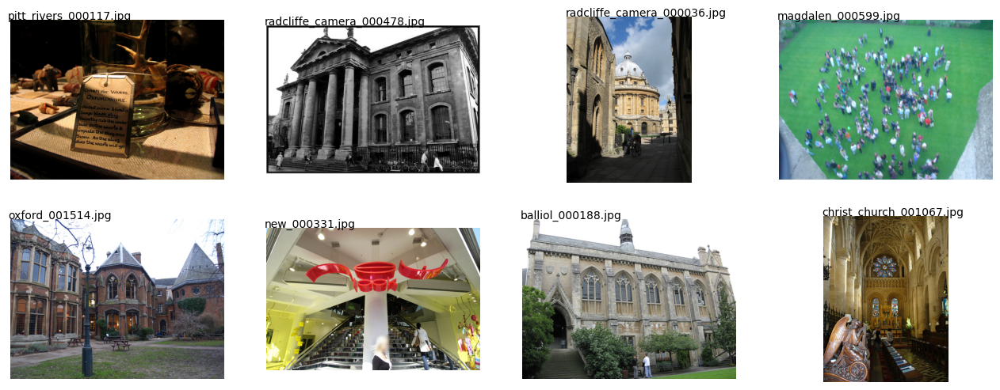

In [102]:
# visualise dataset

# Set the size of the figure
plt.figure(figsize=(16, 6))

# Get a list of all image files in the folder
image_files = glob.glob('./oxford_dataset/*.jpg')

# Pick 8 random images
random_images = random.sample(image_files, 8)

# Loop through the list of random images
for i, image in enumerate(random_images):
    # Read the image file
    img = plt.imread(image)
    
    # Add the image to the plot
    plt.subplot(2, 4, i + 1)
    plt.imshow(img)
    plt.axis('off')
    plt.text(-10, -5, image.split('\\')[-1])

# Show the plot
plt.show()

## Implementation

In [5]:
PATH_TRAIN = ".\\oxford_dataset_splited\\train"
PATH_VALID = ".\\oxford_dataset_splited\\valid"
PATH_TEST = ".\\oxford_dataset_splited\\test"

In [7]:
class TripletData(Dataset):
    def __init__(self, path, transforms, split="train"):
        self.path = path
        self.split = split    # train or valid
        self.cats = 17       # number of categories
        self.transforms = transforms
    
    def __getitem__(self, idx):
        # our positive class for the triplet
        idx = str(idx%self.cats + 1)
        
        # choosing our pair of positive images (im1, im2)
        positives = os.listdir(os.path.join(self.path, str(idx)))
        im1, im2 = random.sample(positives, 2)
        
        # choosing a negative class and negative image (im3)
        negative_cats = [str(x+1) for x in range(self.cats)]
        negative_cats.remove(str(idx))
        negative_cat = str(random.choice(negative_cats))
        negatives = os.listdir(os.path.join(self.path, negative_cat))
        im3 = random.choice(negatives)
        
        im1,im2,im3 = os.path.join(self.path, str(idx), im1), os.path.join(self.path, str(idx), im2), os.path.join(self.path, negative_cat, im3)
        
        im1 = self.transforms(Image.open(im1))
        im2 = self.transforms(Image.open(im2))
        im3 = self.transforms(Image.open(im3))
        
        return [im1, im2, im3]
        
    # we'll put some value that we want since there can be far too many triplets possible
    # multiples of the number of images/ number of categories is a good choice
    def __len__(self):
        return self.cats*8
    

# Transforms
train_transforms = transforms.Compose([
    transforms.Resize((224,224)),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])

val_transforms = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010)),
])


# Datasets and Dataloaders
train_data = TripletData(PATH_TRAIN, train_transforms)
val_data = TripletData(PATH_VALID, val_transforms)

train_loader = torch.utils.data.DataLoader(dataset = train_data, batch_size=32, shuffle=True)
val_loader = torch.utils.data.DataLoader(dataset = val_data, batch_size=32, shuffle=False)

In [5]:
class TripletLoss(nn.Module):
    def __init__(self, margin=1.0):
        super(TripletLoss, self).__init__()
        self.margin = margin
        
    def calc_euclidean(self, x1, x2):
        return (x1 - x2).pow(2).sum(1)
    
    # Distances in embedding space is calculated in euclidean
    def forward(self, anchor, positive, negative):
        distance_positive = self.calc_euclidean(anchor, positive)
        distance_negative = self.calc_euclidean(anchor, negative)
        losses = torch.relu(distance_positive - distance_negative + self.margin)
        return losses.mean()

In [8]:
epochs = 20
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

# Our base model
model = models.resnet18().cuda()
optimizer = optim.Adam(model.parameters(), lr=0.001)
#scheduler = ReduceLROnPlateau(optimizer, factor=0.1, patience=3)
triplet_loss = TripletLoss()

loss_history = []

# Training
for epoch in range(epochs):
    print("Training for epoch : " + str(epoch))
    model.train()
    epoch_loss = 0.0
    for data in train_loader:
        optimizer.zero_grad()
        x1,x2,x3 = data
        e1 = model(x1.to(device))
        e2 = model(x2.to(device))
        e3 = model(x3.to(device)) 
        
        loss = triplet_loss(e1,e2,e3)
        
        epoch_loss += loss
        loss.backward()
        optimizer.step()
        #scheduler.step(loss)
    loss_history.append(epoch_loss)
    print("Train Loss: {}".format(epoch_loss.item()))

Training for epoch : 0
Train Loss: 82.46419525146484
Training for epoch : 1
Train Loss: 47.73774337768555
Training for epoch : 2
Train Loss: 28.65277099609375
Training for epoch : 3
Train Loss: 27.05048370361328
Training for epoch : 4
Train Loss: 21.112031936645508
Training for epoch : 5
Train Loss: 29.65475845336914
Training for epoch : 6
Train Loss: 33.16825485229492
Training for epoch : 7
Train Loss: 24.83290672302246
Training for epoch : 8
Train Loss: 25.489351272583008
Training for epoch : 9
Train Loss: 26.1718807220459
Training for epoch : 10
Train Loss: 23.565404891967773
Training for epoch : 11
Train Loss: 24.41398811340332
Training for epoch : 12
Train Loss: 24.06146812438965
Training for epoch : 13
Train Loss: 22.562501907348633
Training for epoch : 14
Train Loss: 29.691436767578125
Training for epoch : 15
Train Loss: 28.013076782226562
Training for epoch : 16
Train Loss: 18.22279930114746
Training for epoch : 17
Train Loss: 22.53478240966797
Training for epoch : 18
Train Los

In [10]:
torch.save(model, 'model_test_2_resnet.pt')

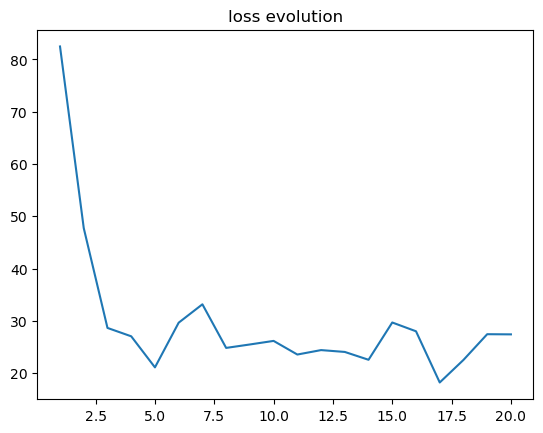

In [30]:
epochs = [x for x in range(1,21)]
double_loss_history = []
for tensor in loss_history:
    double_loss_history.append(tensor.cpu().detach().numpy())
plt.plot(epochs, double_loss_history)
plt.title('loss evolution')
plt.show()

In [10]:
model = torch.load("model_test_2_resnet.pt")
model.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

## Search, Results

In [3]:
import faiss

In [11]:
faiss_index = faiss.IndexFlatL2(1000)   # build the index

im_indices = []
with torch.no_grad():
    for f in glob.glob(os.path.join(PATH_TRAIN, '*/*')):
        im = Image.open(f)
        im = im.resize((224,224))
        im = torch.tensor([val_transforms(im).numpy()]).cuda()
    
        preds = model(im)
        preds = np.array([preds[0].cpu().numpy()])
        faiss_index.add(preds) #add the representation to index
        im_indices.append(f)

In [28]:
faiss_index[0]

TypeError: 'IndexFlatL2' object is not subscriptable

In [29]:
type(im_indices)
import json
# json_im_indices = json.dumps(im_indices)

# # Write the JSON string to a file


faiss.write_index(faiss_index, "faiss_index")

In [40]:
test_sol = {}

pattern = "*.jpg"
with torch.no_grad():
    for f in os.listdir(PATH_TEST):
        print(os.path.join(PATH_TEST,f))
        crt_dir = os.path.join(PATH_TEST,f)
        folder_sol = {}
        for file in glob.glob(os.path.join(crt_dir, pattern)):
            
            im = Image.open(file)
            im = im.resize((224,224))
            im = torch.tensor([val_transforms(im).numpy()]).cuda()

            test_embed = model(im).cpu().numpy()
            _, I = faiss_index.search(test_embed, 5)
            print("Retrieved Image: {}".format(im_indices[I[0][0]]))
            folder_sol[file] = im_indices[I[0][0]]
        test_sol[f] = folder_sol

.\oxford_dataset_splited\test\1
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_001648.jpg
Retrieved Image: .\oxford_dataset_splited\train\9\keble_000208.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_001281.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_002948.jpg
Retrieved Image: .\oxford_dataset_splited\train\11\new_000670.jpg
Retrieved Image: .\oxford_dataset_splited\train\1\all_souls_000105.jpg
Retrieved Image: .\oxford_dataset_splited\train\5\christ_church_000710.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_002516.jpg
Retrieved Image: .\oxford_dataset_splited\train\5\christ_church_000288.jpg
Retrieved Image: .\oxford_dataset_splited\train\12\oriel_000072.jpg
Retrieved Image: .\oxford_dataset_splited\train\8\jesus_000061.jpg
Retrieved Image: .\oxford_dataset_splited\train\1\all_souls_000214.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_002016.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_00255

Retrieved Image: .\oxford_dataset_splited\train\13\oxford_000656.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_000277.jpg
Retrieved Image: .\oxford_dataset_splited\train\2\ashmolean_000228.jpg
Retrieved Image: .\oxford_dataset_splited\train\10\magdalen_000343.jpg
Retrieved Image: .\oxford_dataset_splited\train\3\balliol_000075.jpg
Retrieved Image: .\oxford_dataset_splited\train\5\christ_church_000688.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_001707.jpg
Retrieved Image: .\oxford_dataset_splited\train\11\new_001012.jpg
Retrieved Image: .\oxford_dataset_splited\train\10\magdalen_001051.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_001440.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_002623.jpg
Retrieved Image: .\oxford_dataset_splited\train\10\magdalen_000290.jpg
Retrieved Image: .\oxford_dataset_splited\train\10\magdalen_000563.jpg
Retrieved Image: .\oxford_dataset_splited\train\11\new_000107.jpg
.\oxford_dataset_splited

Retrieved Image: .\oxford_dataset_splited\train\11\new_000391.jpg
Retrieved Image: .\oxford_dataset_splited\train\16\trinity_000338.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_003555.jpg
Retrieved Image: .\oxford_dataset_splited\train\14\pitt_rivers_000030.jpg
Retrieved Image: .\oxford_dataset_splited\train\4\bodleian_000356.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_003077.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_001232.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_002588.jpg
Retrieved Image: .\oxford_dataset_splited\train\9\keble_000183.jpg
Retrieved Image: .\oxford_dataset_splited\train\15\radcliffe_camera_000330.jpg
Retrieved Image: .\oxford_dataset_splited\train\5\christ_church_000340.jpg
Retrieved Image: .\oxford_dataset_splited\train\11\new_001036.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_001654.jpg
Retrieved Image: .\oxford_dataset_splited\train\9\keble_000047.jpg
Retrieved Image: .\ox

Retrieved Image: .\oxford_dataset_splited\train\8\jesus_000116.jpg
Retrieved Image: .\oxford_dataset_splited\train\5\christ_church_000815.jpg
Retrieved Image: .\oxford_dataset_splited\train\5\christ_church_000826.jpg
Retrieved Image: .\oxford_dataset_splited\train\5\christ_church_000738.jpg
Retrieved Image: .\oxford_dataset_splited\train\16\trinity_000133.jpg
Retrieved Image: .\oxford_dataset_splited\train\4\bodleian_000198.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_001747.jpg
.\oxford_dataset_splited\test\17
Retrieved Image: .\oxford_dataset_splited\train\8\jesus_000186.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_003319.jpg
Retrieved Image: .\oxford_dataset_splited\train\17\worcester_000129.jpg
Retrieved Image: .\oxford_dataset_splited\train\17\worcester_000131.jpg
Retrieved Image: .\oxford_dataset_splited\train\17\worcester_000128.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_000656.jpg
Retrieved Image: .\oxford_dataset_splited\tra

Retrieved Image: .\oxford_dataset_splited\train\13\oxford_000890.jpg
Retrieved Image: .\oxford_dataset_splited\train\10\magdalen_000693.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_003190.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_002307.jpg
Retrieved Image: .\oxford_dataset_splited\train\14\pitt_rivers_000062.jpg
Retrieved Image: .\oxford_dataset_splited\train\16\trinity_000332.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_000180.jpg
Retrieved Image: .\oxford_dataset_splited\train\13\oxford_003154.jpg
Retrieved Image: .\oxford_dataset_splited\train\5\christ_church_001044.jpg
Retrieved Image: .\oxford_dataset_splited\train\8\jesus_000083.jpg
Retrieved Image: .\oxford_dataset_splited\train\10\magdalen_000273.jpg
Retrieved Image: .\oxford_dataset_splited\train\15\radcliffe_camera_000426.jpg
Retrieved Image: .\oxford_dataset_splited\train\5\christ_church_001088.jpg
.\oxford_dataset_splited\test\6
Retrieved Image: .\oxford_dataset_splited

In [21]:
import json

In [42]:
# Convert the dictionary to a JSON string
json_test_sol = json.dumps(test_sol)

# Write the JSON string to a file
with open("test_results_2.json", "w") as f:
    f.write(json_test_sol)

In [43]:
#filter all good matches
best_matches = {}
accuracy_results = {}
for k,v in test_sol.items():
    label_best_matches = {}
    accuracy_results_per_class = {}
    total_test_photos = len(v)
    corect_matches = 0
    results = {}
    for reference_image, most_similar_image in v.items():
        #print(reference_image, most_similar_image)
        most_similar_image_label = most_similar_image.split("\\")[3]
        if most_similar_image_label == k: # prezicere corecta
            label_best_matches[reference_image] = most_similar_image
            corect_matches += 1
        #print(reference_image, most_similar_image_label)
        results['corect_match'] = corect_matches
        results['missed_match'] = total_test_photos - corect_matches
        results['accuracy'] = float(corect_matches / total_test_photos)
    accuracy_results[k] = results
    best_matches[k] = label_best_matches

In [52]:
class_id_arr = []
class_accuracy = []
for class_id, results in accuracy_results.items():
    class_id_arr.append(class_id)
    class_accuracy.append(results['accuracy'])


['1', '10', '11', '12', '13', '14', '15', '16', '17', '2', '3', '4', '5', '6', '7', '8', '9'] [0.14285714285714285, 0.2463768115942029, 0.23404255319148937, 0.1, 0.32450331125827814, 0.08333333333333333, 0.20689655172413793, 0.391304347826087, 0.42857142857142855, 0.45, 0.125, 0.13636363636363635, 0.16363636363636364, 0.14285714285714285, 0.125, 0.23529411764705882, 0.15384615384615385]


In [82]:
color_array=["red", "green", "blue", "orange", "purple", "pink", "yellow", "brown", "gray", "black", "darkorange", "cyan", "magenta", "navy", "maroon", "turquoise", "olive"]
classes_legend = {'all_souls': 1, 'ashmolean': 2, 'balliol': 3, 'bodleian': 4, 'christ_church': 5, 'cornmarket': 6, 'hertford': 7, 'jesus': 8, 'keble': 9, 'magdalen': 10, 'new': 11, 'oriel': 12, 'oxford': 13, 'pitt_rivers': 14, 'radcliffe_camera': 15, 'trinity': 16, 'worcester': 17}
swapped_d = dict(zip(classes_legend.values(), classes_legend.keys()))
string_keys_swapped_d = {str(k): v for k, v in swapped_d.items()}
legend = []
for class_id in class_id_arr:
    legend.append(string_keys_swapped_d[class_id])

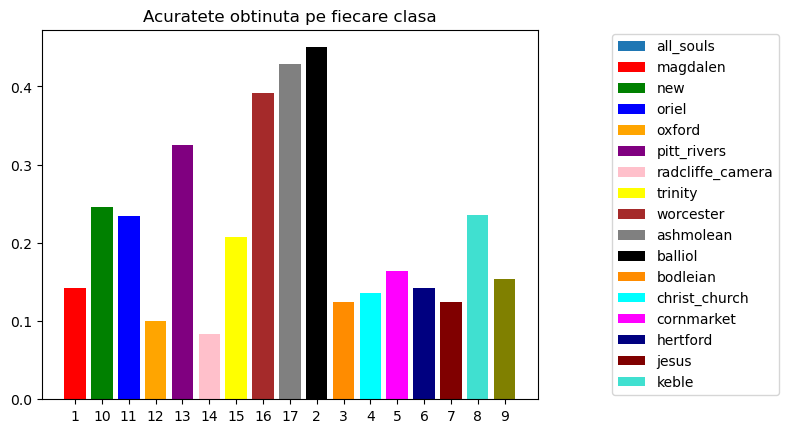

In [83]:
plt.figure
plt.bar(class_id_arr, class_accuracy,)
for x,y,c,lb in zip(class_id_arr,class_accuracy,color_array,legend):
    plt.bar(x, y, color=c,label=lb)
plt.title('Acuratete obtinuta pe fiecare clasa')
plt.legend(legend,bbox_to_anchor=[1.5, 0.5], loc='center right')
plt.show()

C:\Users\Iulian\AppData\Local\Temp\ipykernel_19856\1527860164.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, (ax1, ax2) = plt.subplots(1, 2)


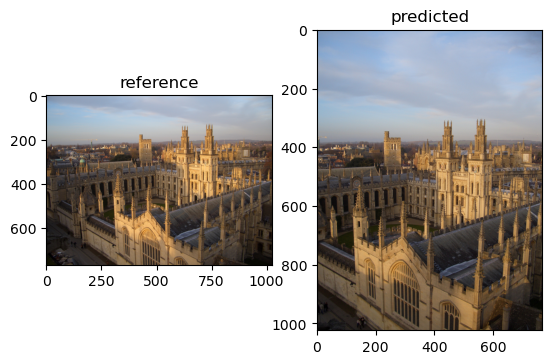

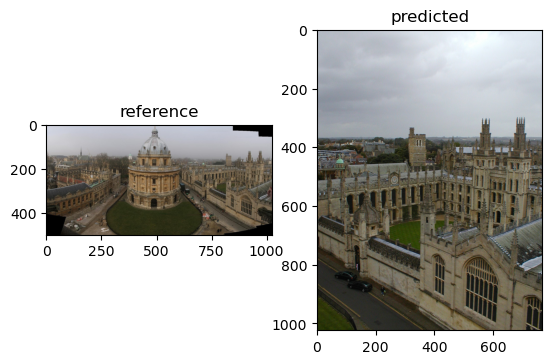

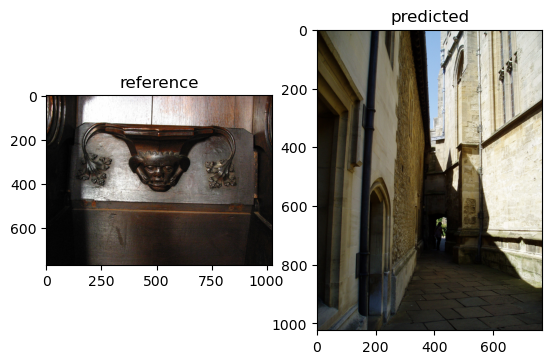

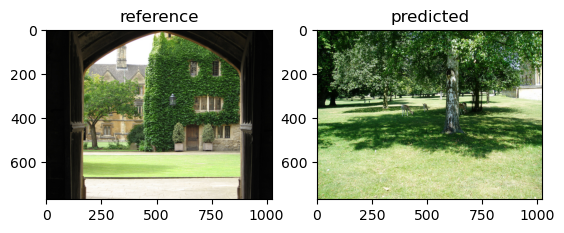

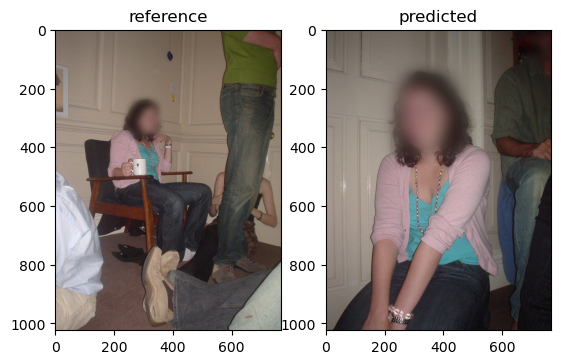

...

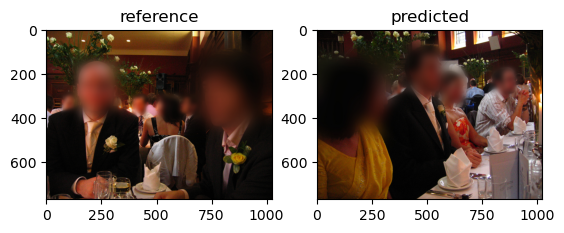

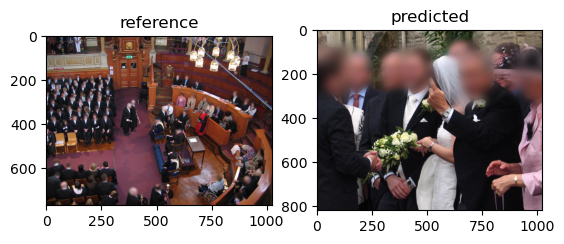

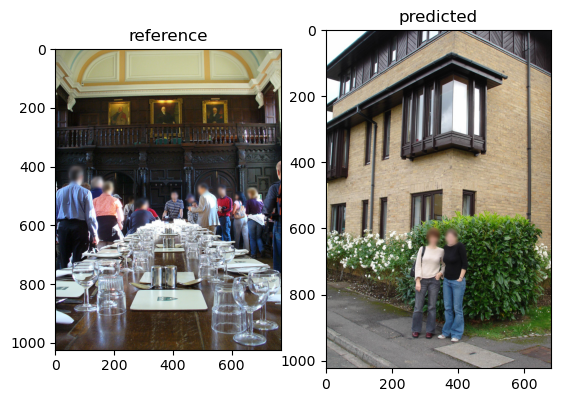

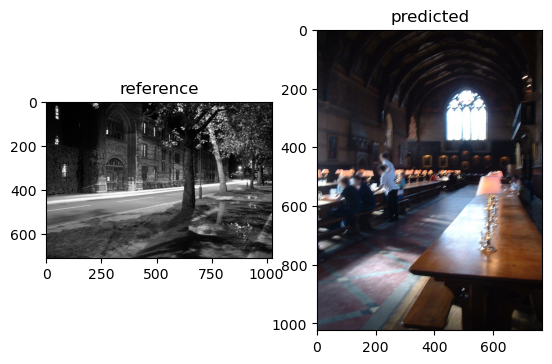

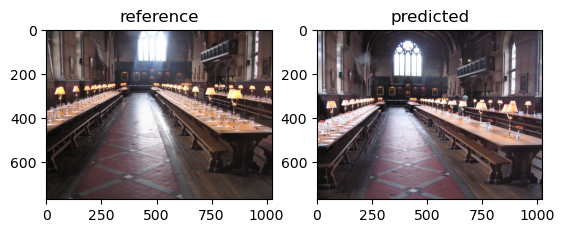

In [92]:
#VISUALISE BEST MATCHES

for k,v in best_matches.items():
    for ref, pred in v.items():
        # Create a figure with two subplots side by side
        fig, (ax1, ax2) = plt.subplots(1, 2)
        
        image1 = plt.imread(ref)
        image2 = plt.imread(pred)

        # Show the first image on the left subplot
        ax1.imshow(image1)
        ax1.set_title("reference")

        # Show the second image on the right subplot
        ax2.imshow(image2)
        ax2.set_title("predicted")

# Show the figure
plt.show()